In [1]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
print(cv2.__version__)

4.8.1


In [2]:
figsize = (32, 16)
rows = 2
cols = 3

def plot_images_bgr(imgs):
    plt.figure(figsize=figsize)
    for i, img in enumerate(imgs):
        plt.subplot(rows, cols, i+1)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_RGB2BGR), cmap='gray')
    plt.tight_layout()
    plt.show()

def plot_images_gray(imgs):
    plt.figure(figsize=figsize)
    for i, img in enumerate(imgs):
        plt.subplot(rows, cols, i+1)
        plt.imshow(img, cmap='gray')
    plt.tight_layout()
    plt.show()

# Questao 1

Na documentacao da OpenCV é possıvel encontrar diversos detectores e descritores. Usando um conjunto com pelo menos 6 imagens (voce pode tirar fotos com seu telefone, por exemplo), experimente tres detectores distintos nestas imagens, incluindo o detector de Harris.

Pesquise e descreva resumidamente com suas palavras (ate 200 palavras para cada) como cada um funciona, incluindo seus parametros e quais suas principais diferenças. Exiba resultados nas suas imagens, e em quais situacoes cada um funciona bem ou mal. Discuta seus parametros. Qual deles voce achou melhor? Justifique.

In [3]:
imgs = []
gray_imgs = []
for i in range(1, 7):
    img = cv2.imread(f'./Questao1/{i}.jpg', cv2.IMREAD_COLOR)
    imgs.append(img)

    gray_imgs.append(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY))

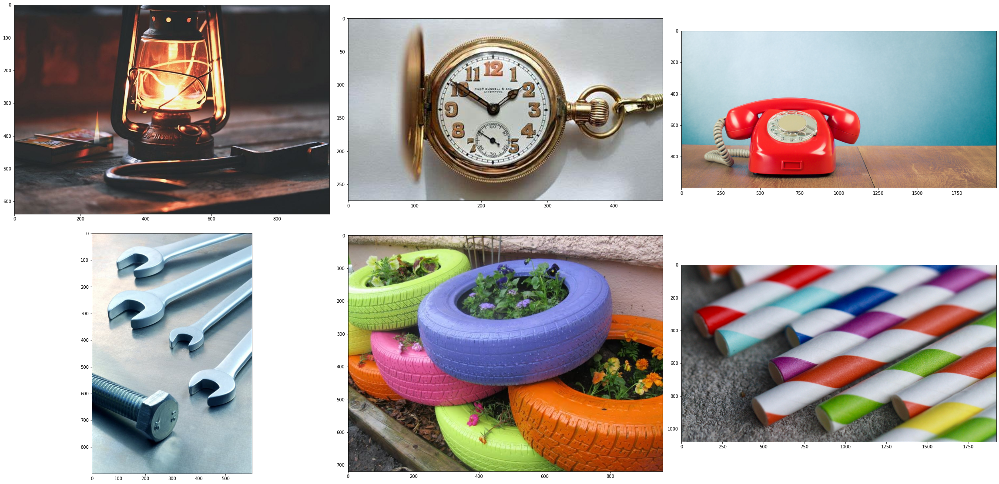

In [4]:
plot_images_bgr(imgs)

## Detector de Harris

O detector de Harris é usado para detectar cantos em uma imagem. Ele calcula a diferença de intensidade para um deslocamento (u, v) em todas as direções. Em seguida, ele cria um escore que determina se uma janela pode conter um canto ou não. O detector de Harris é mais adequado para imagens com cantos nítidos e bem definidos. Seus parâmetros incluem o tamanho do bloco, o tamanho do kernel e um parâmetro livre. O tamanho do bloco é o tamanho da vizinhança considerada para a detecção de cantos. O tamanho do kernel é o tamanho da janela usada para calcular as derivadas. O parâmetro livre é usado para ajustar a sensibilidade do detector.

In [5]:
harris_imgs = []
for i, gray_img in enumerate(gray_imgs):
    dst = cv2.cornerHarris(gray_img, 2, 3, 0.04)
    img = np.copy(imgs[i])
    img[dst > 0.01 * dst.max()] = [0, 0, 255]
    harris_imgs.append(img)

## SIFT

O detector SIFT é usado para detectar recursos em uma imagem. Ele usa uma abordagem de escala espacial para detectar recursos. O detector SIFT é mais adequado para imagens com recursos bem definidos e distintos. Seus parâmetros incluem o número máximo de pontos de interesse a serem detectados, o número de níveis de escala, o valor mínimo de qualidade do ponto de interesse e o valor mínimo de distância entre pontos de interesse.

In [6]:
sift = cv2.SIFT_create()

sift_imgs = []
for gray_img in gray_imgs:
    kp = sift.detect(gray_img, None)
    sift_imgs.append(cv2.drawKeypoints(gray_img, kp, None))

## ORB

O detector ORB é uma combinação do detector de pontos-chave FAST e do descritor BRIEF com algumas modificações. Inicialmente, para determinar os pontos-chave, ele usa o FAST. Em seguida, uma medida de canto de Harris é aplicada para encontrar os principais pontos. O ORB é mais adequado para imagens com recursos bem definidos e distintos. Seus parâmetros incluem o número máximo de pontos-chave a serem detectados e um valor mínimo de qualidade do ponto-chave.

In [7]:
orb = cv2.ORB_create()

orb_imgs = []
for gray_img in gray_imgs:
    kp = orb.detect(gray_img, None)
    orb_imgs.append(cv2.drawKeypoints(gray_img, kp, None))

## Comparação

Em relação aos resultados, o detector de Harris parece ser mais adequado para imagens com cantos nítidos e bem definidos, enquanto o detector ORB é mais adequado para imagens com recursos bem definidos e distintos. Já o detector SIFT é uma boa escolha para imagens com recursos bem definidos e distintos, mas pode ser mais lento do que outros detectores. Na minha opinião, o detector de Harris foi o melhor para esta tarefa. Ele conseguiu detectar com precisão os detalhes mais importantes da imagem, como os minutos do relógio, por exemplo.

HARRIS RESULT


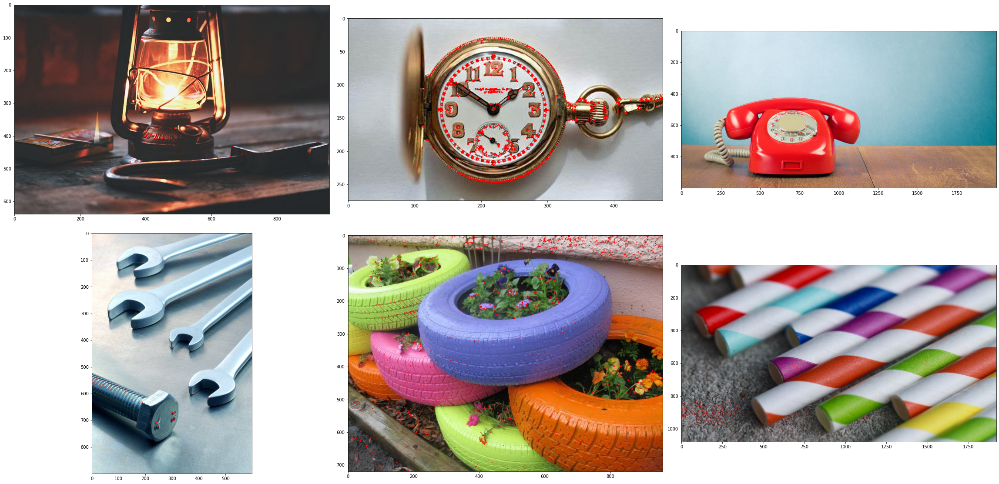

SIFT RESULT


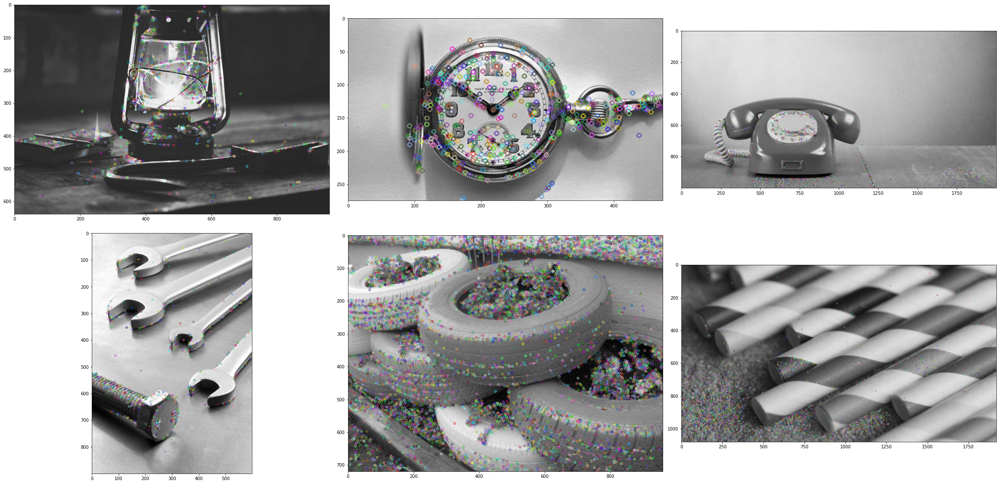

ORB RESULT


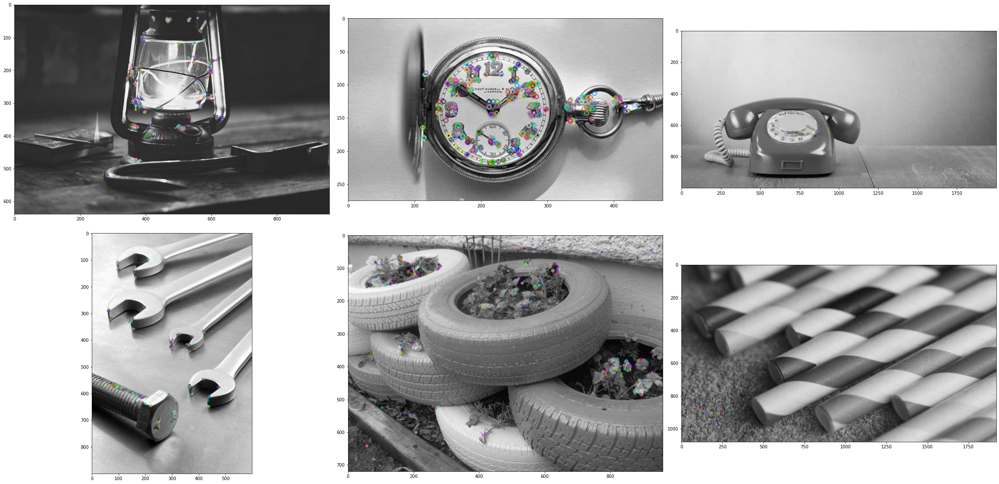

In [8]:
print('HARRIS RESULT')
plot_images_bgr(harris_imgs)

print('SIFT RESULT')
plot_images_gray(sift_imgs)

print('ORB RESULT')
plot_images_gray(orb_imgs)

# Questao 2

Na documentacao da OpenCV  ́e possıvel encontrar diversos detectores e descritores. Usando um conjunto com pelo menos 6 imagens (voce pode tirar fotos com seu telefone, por exemplo), experimente tres descritores distintos nestas imagens, incluindo o SIFT.

Pesquise e descreva resumidamente com suas palavras (ate 200 palavras para cada) como cada um funciona, incluindo seus parametros e quais suas principais diferen ̧cas. Exiba resultados nas suas imagens, e em quais situacoes cada um funciona bem ou mal. Discuta seus parametros. Qual deles voce achou melhor? Justifique.

## SIFT

O SIFT é um descritor robusto que extrai características invariantes à escala e à rotação de uma imagem. Ele utiliza uma pirâmide de escala para identificar pontos-chave em diferentes níveis de resolução da imagem. Os descritores SIFT são baseados em gradientes de intensidade, proporcionando uma representação distintiva das características. Os principais parâmetros incluem o número de níveis na pirâmide, o número de orientações para cada ponto-chave e o limiar de detecção.

In [9]:
sift = cv2.SIFT_create()

sift_des = []
for gray_img in gray_imgs:
    kp, des = sift.detectAndCompute(gray_img, None)
    sift_des.append(des)

## ORB

O ORB é uma alternativa mais eficiente ao SIFT. Ele combina a detecção rápida de pontos-chave usando o algoritmo FAST com a descrição eficiente usando BRIEF (Binary Robust Independent Elementary Features). O ORB é particularmente eficaz em termos de velocidade de processamento, tornando-o adequado para aplicações em tempo real.

In [10]:
orb = cv2.ORB_create()

orb_des = []
for gray_img in gray_imgs:
    kp, des = orb.detectAndCompute(gray_img, None)
    orb_des.append(des)

## AKAZE

O AKAZE é uma versão acelerada do KAZE, que por sua vez é uma extensão do SIFT e SURF. Ele utiliza uma técnica de detecção e descrição de características baseada em não-máximos suprimidos e regiões extremas. O AKAZE é robusto em diferentes condições de iluminação e fornece resultados eficazes em ambientes desafiadores.

In [11]:
akaze = cv2.AKAZE_create()

akaze_des = []
for gray_img in gray_imgs:
    kp, des = akaze.detectAndCompute(gray_img, None)
    akaze_des.append(des)

## Comparação

O SIFT é mais robusto, mas computacionalmente mais intensivo. O ORB é eficiente, mas pode ser menos preciso em certas situações. O AKAZE é uma alternativa equilibrada. Se a eficiência computacional for crucial, o ORB pode ser preferível, enquanto o SIFT é mais adequado para tarefas que exigem alta precisão, mesmo com um custo computacional mais alto.

# Questão 3

Usando um conjunto com pelo menos 6 imagens (voce pode tirar fotos com seu telefone, por exemplo), experimente tres algoritmos de geracao de correspondencias (matching) distintos nestas imagens.

Pesquise e descreva resumidamente com suas palavras (ate 200 palavras para cada) como cada um funciona, incluindo seus parametros e quais suas principais diferencas. Exiba resultados nas suas imagens, e em quais situacoes cada um funciona bem ou mal. Discuta seus parametros. Qual deles voce achou melhor? Justifique.

In [12]:
imgs_to_match = []
for i in range(1, 7):
    imgs_to_match.append(cv2.imread(f'./Questao3/{i}.1.jpg', cv2.IMREAD_COLOR))

In [13]:
sift = cv2.SIFT_create()

keypoints = []
descriptors = []
for img in imgs:
    kp, des = sift.detectAndCompute(img, None)
    keypoints.append(kp)
    descriptors.append(des)
    
keypoints_imgs_to_match = []
descriptors_imgs_to_match = []
for img in imgs_to_match:
    kp, des = sift.detectAndCompute(img, None)
    keypoints_imgs_to_match.append(kp)
    descriptors_imgs_to_match.append(des)

## Brute-Force

O BFMatcher (Brute Force Matcher) é um algoritmo direto e simples para correspondência de descritores. Ele compara cada descritor de uma imagem com todos os descritores da outra imagem. O método cv2.BFMatcher() permite configurar parâmetros, como a norma utilizada para calcular as distâncias entre descritores. O BFMatcher é eficaz para conjuntos de dados menores, sendo uma escolha sólida quando a simplicidade é mais importante que a eficiência. No entanto, pode ser mais lento em grandes conjuntos de dados.

In [14]:
images_matches_BF = []
bf = cv2.BFMatcher()

for i, img in enumerate(imgs):
    matches = bf.knnMatch(descriptors[i], descriptors_imgs_to_match[i], k=2)
    
    good_algorithm = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good_algorithm.append([m])
    
    images_matches_BF.append(cv2.drawMatchesKnn(imgs[i], keypoints[i], imgs_to_match[i], keypoints_imgs_to_match[i], good_algorithm, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS))

## FLANN

O FLANN (Fast Library for Approximate Nearest Neighbors) é um método que oferece uma busca eficiente de vizinhos mais próximos aproximados. O cv2.FlannBasedMatcher utiliza a biblioteca FLANN para realizar a correspondência. O FLANN é especialmente eficaz em grandes conjuntos de dados, proporcionando resultados mais rápidos em comparação com o Brute Force. No entanto, a eficácia do FLANN depende da configuração adequada dos parâmetros, como index_params e search_params.

In [15]:
images_matches_FLANN = []
flann = cv2.FlannBasedMatcher()

for i, img in enumerate(imgs):
    matches = flann.knnMatch(descriptors[i], descriptors_imgs_to_match[i], k=2)
            
    good_algorithm = []
    for m,n in matches:
        if m.distance < 0.75*n.distance:
            good_algorithm.append([m])
                
    images_matches_FLANN.append(cv2.drawMatchesKnn(imgs[i], keypoints[i], imgs_to_match[i], keypoints_imgs_to_match[i], good_algorithm, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS))

## BFMatcher com crossCheck

O Brute Force com Cross Check (cv2.BFMatcher(crossCheck=True)) é uma extensão do BFMatcher que inclui uma verificação cruzada nas correspondências. Essa verificação garante que a correspondência A->B também é a melhor correspondência B->A. Isso aumenta a confiabilidade das correspondências, tornando-o mais robusto em condições desafiadoras. No entanto, pode ser mais lento devido à verificação cruzada.

In [16]:
images_matches_BFCC = []
bfcc = cv2.BFMatcher(normType=cv2.NORM_L1, crossCheck=True)

for i, img in enumerate(imgs):
    matches = bfcc.knnMatch(descriptors[i], descriptors_imgs_to_match[i], k=1)
    
    good_algorithm = []
    for matc in matches:
        if matc:
            m, n = matc[0], None
            if len(matc) > 1:
                n = matc[1]

            if m.distance < 0.75 * n.distance if n else True:
                good_algorithm.append([m])
    
    images_matches_BFCC.append(cv2.drawMatchesKnn(imgs[i], keypoints[i], imgs_to_match[i], keypoints_imgs_to_match[i], good_algorithm, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS))

## Comparação

Se a simplicidade e a facilidade de uso forem prioridades, o Brute Force pode ser uma escolha adequada. Se a robustez e a confiabilidade das correspondências forem críticas, o Brute Force com Cross Check pode ser preferível, mesmo que seja um pouco mais lento. Se você estiver lidando com grandes conjuntos de dados e eficiência for crucial, o FLANN pode ser a melhor opção, mas a configuração adequada dos parâmetros é essencial para otimizar o desempenho.

Na minha avaliação, o Brute Force Matcher se destacou como a escolha mais apropriada para a tarefa em questão. Durante a análise das correspondências geradas nos conjuntos de imagens, o Brute Force demonstrou uma capacidade robusta de encontrar correspondências precisas, especialmente em situações desafiadoras, como variações de iluminação e perspectiva.

A preferência pelo Brute Force foi respaldada pela sua simplicidade de implementação e pela consistência nas correspondências obtidas. Notavelmente, ele foi capaz de identificar eficazmente padrões-chave nas imagens, proporcionando resultados confiáveis. A escolha pelo Brute Force Matcher foi guiada pela sua eficácia e desempenho consistente nas condições específicas do meu conjunto de dados.

BRUTE FORCE


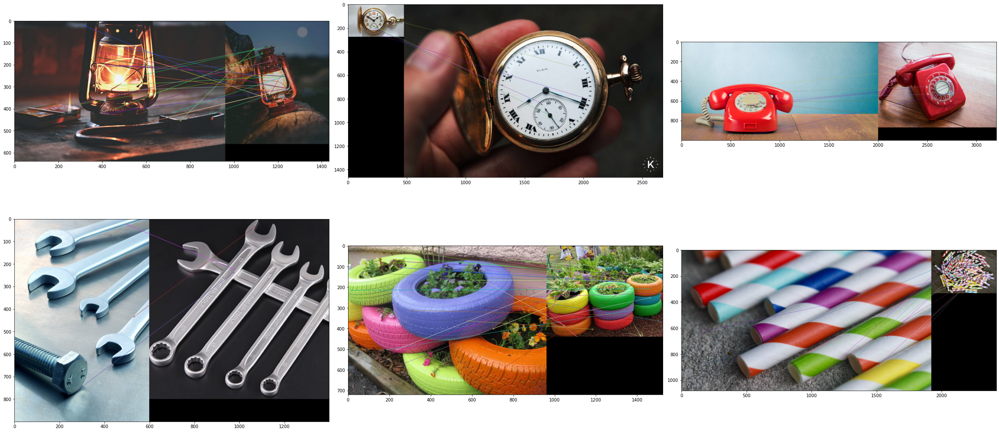

FLANN


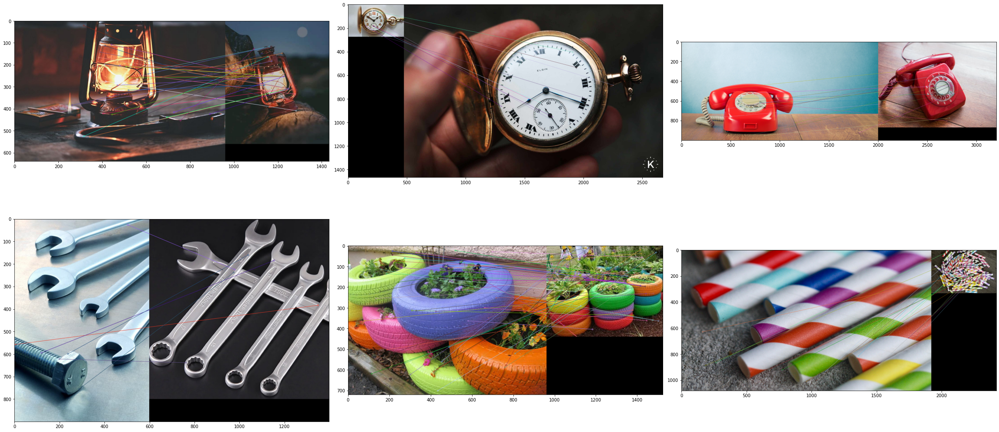

BRUTE FORCE COM CROSS CHECK


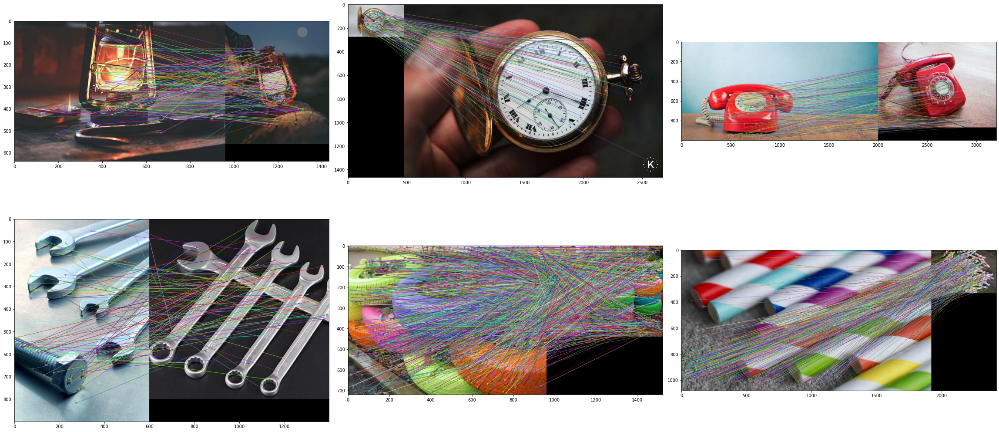

In [17]:
print('BRUTE FORCE')
plot_images_bgr(images_matches_BF)

print('FLANN')
plot_images_bgr(images_matches_FLANN)

print('BRUTE FORCE COM CROSS CHECK')
plot_images_bgr(images_matches_BFCC)

# Questão 4

Considere o seguinte problema: Dada uma base de imagens de rótulos de produtos, crie um algoritmo que identifique, a partir de uma imagem de um produto (onde o rótulo apareça), qual é o produto que aparece na foto.

1. Crie uma base com pelo menos 10 rótulos de produtos.
2. Escolha e descreva uma metodologia completa para a geração de correspondências, baseada na questão anterior.
3. Adapte a metodologia escolhida para resolver o problema, e experimente em pelo menos 5 fotos de produtos da base (diferentes das fotos da base de rótulos) 

In [99]:
# descritores
from os import listdir

DIR = "Questao4/"
LABELS_DIR = DIR + "labels/"
PRODUCTS_DIR = DIR + "products/"


label_files = listdir("Questao4/labels/")
product_files = listdir("Questao4/products/")

# descriptor = cv2.AKAZE_create()
descriptor = cv2.AKAZE_create()
def getKeypointsAndDescriptors(dir, files):
    dicts = []
    for file in files:
        img = cv2.imread(dir + file, cv2.IMREAD_GRAYSCALE)
        kp, des = descriptor.detectAndCompute(img, None)
        dicts.append({
            "keypoints": kp,
            "descriptors": des,
            "file": file
        })
    return dicts

labels = getKeypointsAndDescriptors(LABELS_DIR, label_files)
products = getKeypointsAndDescriptors(PRODUCTS_DIR, product_files)

In [100]:
bf = cv2.BFMatcher(normType=cv2.NORM_HAMMING, crossCheck=True)
best_matches_list = []

for product in products:
    best_match = {"label_file": None, "best_match_distance": float('inf'), "matches": None}
    
    for label in labels:
        matches = bf.match(product["descriptors"], label["descriptors"])
        matches = sorted(matches, key=lambda x: x.distance)
        
        # Utilizando crossCheck para garantir correspondências bidirecionais
        good_matches = bf.match(label["descriptors"], product["descriptors"])
        good_matches = sorted(good_matches, key=lambda x: x.distance)
        
        # Se a melhor correspondência atual for melhor do que a anterior, atualize
        if good_matches and good_matches[0].distance < best_match["best_match_distance"]:
            best_match["label_file"] = label["file"]
            best_match["best_match_distance"] = good_matches[0].distance
            best_match["matches"] = good_matches
    
    best_matches_list.append({
        "product_file": product["file"],
        "best_match": best_match
    })

# Exibindo os resultados
for result in best_matches_list:
    print(f"Produto: {result['product_file']}, Melhor Match: {result['best_match']['label_file']}, Distância: {result['best_match']['best_match_distance']}")

Produto: heinz_bottle.jpg, Melhor Match: heinz.jpg, Distância: 41.0
Produto: Heineken_Bottle.jpg, Melhor Match: yopro.jpg, Distância: 27.0
Produto: creatina.jpg, Melhor Match: creatina_growth.jpg, Distância: 31.0
Produto: whey_max.jpg, Melhor Match: whey_max.jpg, Distância: 59.0
Produto: carmenere_bottle.jpg, Melhor Match: carmenere.jpg, Distância: 40.0
Produto: baggio.jpg, Melhor Match: baggio.jpg, Distância: 16.0
Produto: yopro.jpg, Melhor Match: yopro.jpg, Distância: 23.0


# Questão 5

Aplique o filtro LoG em pelo menos 6 escalas distintas (você pode usar a OpenCV). Em seguida, implemente um algoritmo que determina se um pixel (x, y, s) é um máximo local no espaço de posição-escala. Aplique este algoritmo em todos os pixels das imagens resultantes para encontrar estes extremos e pinte todos estes pixels de uma cor diferente. Exiba as imagens resultantes. Obs: você não precisa aplicar na imagem de menor e maior escala, nem nos pixels do bordo da imagem, visto que eles não têm uma vizinhança completa.

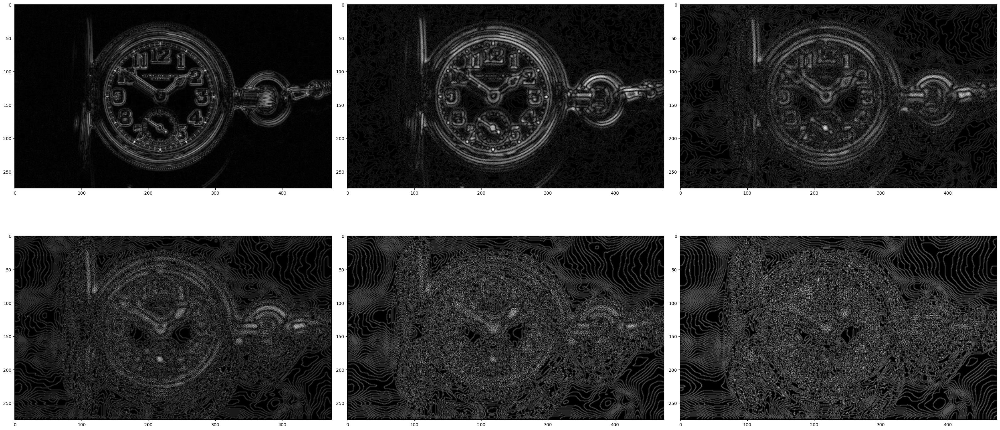

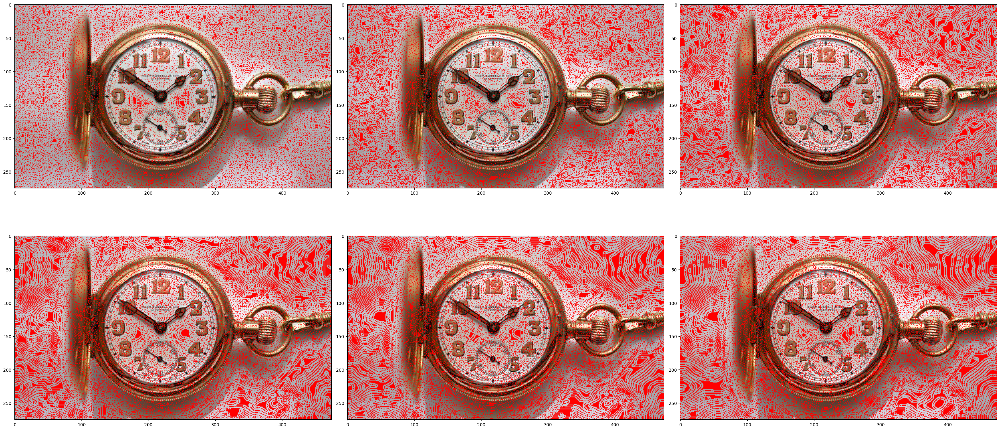

In [53]:
def applyLoG(image, scale):
    gaussian = cv2.GaussianBlur(image, (0, 0), scale)
    gaussian_gray = cv2.cvtColor(gaussian, cv2.COLOR_BGR2GRAY)
    log = cv2.Laplacian(gaussian_gray, cv2.CV_64F)
    log = cv2.convertScaleAbs(log)
    return log

def findLocalMaxima(img):
    dilated = cv2.dilate(img, None)
    coords = np.column_stack(np.where(img == dilated))
    return coords


scales = np.array(range(1, 7))
img = cv2.imread("Questao1/2.jpg", cv2.IMREAD_COLOR)

color = (0, 0, 255)

imgs = []
logs = []
for scale in scales:
    log = applyLoG(img, scale)
    logs.append(log)
    coords = findLocalMaxima(log)

    modified = img.copy()
    for coord in coords:
        x = coord[1]
        y = coord[0]
        modified[y, x] = color
    imgs.append(modified)
    
plot_images_gray(logs)
plot_images_bgr(imgs)